In [1]:
import requests
import geopandas as gpd
import matplotlib.pyplot as plt
from pandas import json_normalize
from shapely.geometry import LineString
import folium

/home/taryn/.local/lib/python3.8/site-packages/geopandas/_compat.py:84: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.8.1-CAPI-1.13.3). Conversions between both will be slow.
  warnings.warn(


In [2]:
# Load shapefiles with larch range data and WA state boundary
subalpine_larch = gpd.read_file('./SubalpineLarch_WAExtent/SubalpineLarch_WAExtent.shp').to_crs(epsg=4326)
western_larch = gpd.read_file('./WesternLarch_WAExtent/WesternLarch_WAExtent.shp').to_crs(epsg=4326)
states = gpd.read_file('./cb_2018_us_state_500k/cb_2018_us_state_500k.shp').to_crs(epsg=4326)
washington = states[states.NAME=='Washington']

<AxesSubplot:>

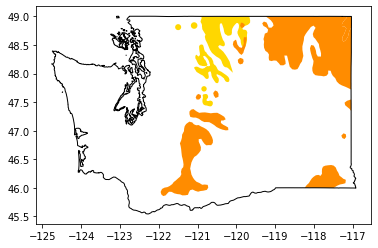

In [3]:
# Data check: plot larch ranges on WA boundary
fig, ax = plt.subplots()
subalpine_larch.plot(ax=ax, color='gold', label='Subalpine Larch')
western_larch.plot(ax=ax, color='darkorange', label='Western Larch')
washington.plot(ax=ax, edgecolor='black', facecolor='none')

In [4]:
# WA trails API: access trail data
api_url = 'https://gismanager.rco.wa.gov/arcgis/rest/services/OpenData/WA_RCO_OpenData/MapServer/9/query?where=1%3D1&outFields=*&outSR=4326&f=json'

exceededTransferLimit = True
result_offset = 0
results_list = []

while exceededTransferLimit is True:
    response = requests.get(api_url+f'&resultOffset={result_offset}')
    response_json = response.json()
    results_list.extend(response_json['features'])
    exceededTransferLimit = 'exceededTransferLimit' in response_json.keys()
    result_offset += 1000


In [5]:
# Convert trails API results to GeoDataFrame
result = json_normalize(results_list)
result['geometry'] = [LineString(x[0]) for x in result['geometry.paths']]
trails = gpd.GeoDataFrame(result, geometry='geometry').set_crs(epsg=4326)
trails.head()

,attributes.TR_NM,attributes.TR_ALT_NM,attributes.TR_NUM,attributes.TR_SYS,attributes.ATV,attributes.BICYCLE,attributes.DOG_SLED,attributes.FOUR_WHEEL_DRIVE,attributes.HIKER_PEDESTRIAN,attributes.MOTORCYCLE,...,attributes.REVIEW_COMMENTS,attributes.QA_STATUS,attributes.created_user,attributes.created_date,attributes.last_edited_user,attributes.last_edited_date,attributes.GlobalID,attributes.OBJECTID,geometry.paths,geometry
0,,,,UNKNOWN,No,Yes,,No,Yes,No,...,Maintenance/ownership unclear,6,JENNYK,1.419273e+12,JENNYK,1508777414000,{59066072-FD8D-4B3E-9341-8AC71267C761},32757,"[[[-122.839172999583, 47.045063222907565], [-1...","LINESTRING (-122.83917 47.04506, -122.83895 47..."
1,Beverly Turnpike,,1391,NATIONAL FOREST SYSTEM TRAIL,No,Yes,,No,Yes,No,...,Accesses Alpine Lakes Wilderness - atts may ch...,6,JENNYK,1.419273e+12,JENNYK,1508454932000,{3FFCC608-2CBF-4AEA-8CC7-FEF442656BAB},33399,"[[[-120.89653469968086, 47.45423579929784], [-...","LINESTRING (-120.89653 47.45424, -120.89651 47..."
2,,,,UNKNOWN,Unknown,Unknown,,,Unknown,Unknown,...,May no longer be trail - not visible in imagery,6,JENNYK,1.419273e+12,JENNYK,1508777260000,{0DA63E45-6D47-4EDF-AAF6-C3F94CD617B7},33400,"[[[-120.93305352648622, 48.201114384787736], [...","LINESTRING (-120.93305 48.20111, -120.93303 48..."
3,Willapa Hills,,,STATE GOVERNMENT TRAIL,No,Yes,Unknown,No,Yes,No,...,surface type may vary,6,JENNYK,1.419273e+12,JENNYK,1508454932000,{60C7321F-0E9A-4630-B6E8-20450F05C019},33405,"[[[-123.481280358929, 46.54402876879988], [-12...","LINESTRING (-123.48128 46.54403, -123.48111 46..."
4,Willapa Hills,,,STATE GOVERNMENT TRAIL,No,Yes,Unknown,No,Yes,No,...,surface type may vary,6,JENNYK,1.419273e+12,JENNYK,1508454932000,{5E7093B3-172C-45CC-97D8-F7B97BE357FD},33409,"[[[-123.54826925564319, 46.55954755633912], [-...","LINESTRING (-123.54827 46.55955, -123.54768 46..."


<AxesSubplot:>

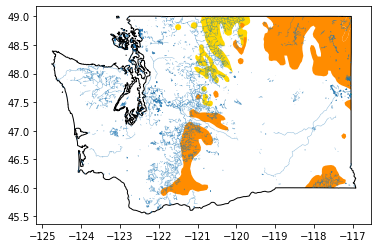

In [6]:
# Data check: plot trails on top of larch ranges
fig, ax = plt.subplots()
subalpine_larch.plot(ax=ax, color='gold', label='Subalpine Larch')
western_larch.plot(ax=ax, color='darkorange', label='Western Larch')
washington.plot(ax=ax, edgecolor='black', facecolor='none')
trails.plot(ax=ax, linewidth=0.5, alpha=0.5)

In [7]:
# Find trails that intersect with subalpine larch range
sl_trails_ind, _ = subalpine_larch.geometry.sindex.query_bulk(trails.geometry, predicate='intersects')
subalpinelarch_trails = trails.iloc[sl_trails_ind]

<AxesSubplot:>

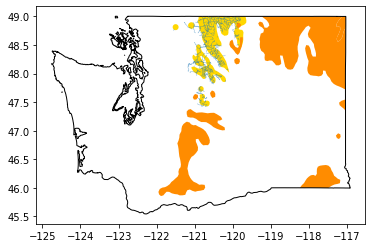

In [8]:
# Data check: plot subalpine larch trails on top of larch ranges
fig, ax = plt.subplots()
subalpine_larch.plot(ax=ax, color='gold', label='Subalpine Larch')
western_larch.plot(ax=ax, color='darkorange', label='Western Larch')
washington.plot(ax=ax, edgecolor='black', facecolor='none')
subalpinelarch_trails.plot(ax=ax, linewidth=0.5, alpha=0.5)

In [9]:
# Find trails that intersect with western larch range
wl_trails_ind, _ = western_larch.geometry.sindex.query_bulk(trails.geometry, predicate='intersects')
westernlarch_trails = trails.iloc[wl_trails_ind]

<AxesSubplot:>

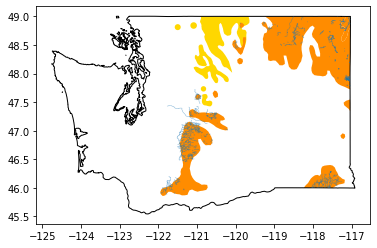

In [10]:
# Data check: plot western larch trails on top of larch ranges
fig, ax = plt.subplots()
subalpine_larch.plot(ax=ax, color='gold', label='Subalpine Larch')
western_larch.plot(ax=ax, color='darkorange', label='Western Larch')
washington.plot(ax=ax, edgecolor='black', facecolor='none')
westernlarch_trails.plot(ax=ax, linewidth=0.5, alpha=0.5)

In [11]:
# Make an interactive map with folium!

# Define center coordinates for opening map
washington_coords = [47.25, -121.0]

# Initialize the map
my_map = folium.Map(location=washington_coords, zoom_start=7, min_zoom=7, min_lat=45, max_lat=50, min_lon=-125, max_lon=-116, tiles='Stamen Terrain')

# Add larch range polygons
sl_poly = folium.GeoJson(
    data=subalpine_larch['geometry'], 
    name='Subalpine larch range', 
    style_function=lambda x: {'fillColor': 'gold', 'color': 'gold', 'weight': 1})
sl_poly.add_to(my_map)
wl_poly = folium.GeoJson(
    data=western_larch['geometry'], 
    name='Western larch range', 
    style_function=lambda x: {'fillColor': 'darkorange', 'color': 'darkorange', 'weight': 1})
wl_poly.add_to(my_map)

# Create HTML template for each trail with trail name and link to WTA search
def writeHTMLTemplate(row):
    trail_name = row['attributes.TR_NM']
    popup_html = "<b>%s</b><br><a href='https://www.wta.org/go-outside/hikes/hike_search?title=%s' target='_blank'>Search for hike on WTA</a>" % (trail_name, trail_name.lower().replace(' ','+'))
    return popup_html
subalpinelarch_trails['html_to_display'] = subalpinelarch_trails.apply(writeHTMLTemplate, axis=1)
westernlarch_trails['html_to_display'] = westernlarch_trails.apply(writeHTMLTemplate, axis=1)

# Add trails to map, with HTML popups containing link to search trail name on WTA
sl_trails = folium.GeoJson(
    data=subalpinelarch_trails, 
    name='Subalpine larch trails', 
    style_function=lambda x: {'color': 'brown', 'weight': 1.5},
    highlight_function=lambda x: {'color': 'cyan', 'weight': 2},
    popup=folium.features.GeoJsonPopup(fields=['html_to_display'], labels=False))
sl_trails.add_to(my_map)
wl_trails = folium.GeoJson(
    data=westernlarch_trails, 
    name='Western larch trails', 
    style_function=lambda x: {'color': 'brown', 'weight': 1.5},
    highlight_function=lambda x: {'color': 'cyan', 'weight': 2},
    popup=folium.features.GeoJsonPopup(fields=['html_to_display'], labels=False))
wl_trails.add_to(my_map)

# Add checkbox to turn layers on/off
folium.LayerControl().add_to(my_map)

my_map.save('./WashingtonLarchHikes.html')

my_map

/home/taryn/.local/lib/python3.8/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)
